# Data Analysis and Prophet MVP

This notebook contains initial analysis of the energy data and a few prophet models. The goal of this notebook is to get a reasonably accurate model created so I can implement into flask app. I will improve model performance in later iterations.

Notebook Contents:
- Import Data
- EDA and Initial Analysis
- Prophet models

I will use two metrics to guage the performance of the models: r-squared and MAE.

A great resource for this analysis was a blog by evergreeeninnovations on forecasting with Facebook Prophet. This article can be found [here](https://www.evergreeninnovations.co/time-series-forecasting-with-facebook-prophet/)

In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from fbprophet import Prophet
import psycopg2
from sklearn.metrics import r2_score as r2, mean_absolute_error as mae

## Import Data
The energy data I will be using is stored in a local postgres database. I will use psycopg2 to query it and store in pandas dataframe.

In [2]:
# make connection to database
conn = psycopg2.connect('dbname=solarforecast user=postgres password=Live.absolutely1')

In [3]:
# create cursor object
cur = conn.cursor()

In [4]:
# Query time and inverter column for all entries in database
cur.execute('''
    SELECT time, energy FROM energy;
''')
# Fetch all rows and store in data_query
data_query = cur.fetchall()

In [5]:
# Close cursor and database connection
cur.close()
conn.close()

In [6]:
data_query[-1]

(datetime.datetime(2021, 1, 11, 23, 0), 0.0)

The query returned a list of tuples, I can store this directly into pandas dataframe. Prophet requires certain column names for modeling. The time component should be in column 'ds' and the value should be in column 'y'.

In [7]:
df = pd.DataFrame(data_query, columns=['ds', 'y'])

In [8]:
df.head()

,ds,y
0,2018-07-01 00:00:00,0.0
1,2018-07-01 01:00:00,0.0
2,2018-07-01 02:00:00,0.0
3,2018-07-01 03:00:00,0.0
4,2018-07-01 04:00:00,0.0


In [9]:
df.dtypes

ds    datetime64[ns]
y            float64
dtype: object

## EDA

Energy production from solar systems are primarily dependent on two components: time and weather conditions. I will not be including weather conditions in my initial models, so I will focus on exploring the time component for now. 

The data used in this project is from a solar farm located at the University of Illinois Urbana-Champaign. As this is located in the midwest, I expect daily and yearly seasonalities to have a substantial impact on energy production.

To start I will look at yearly patterns in the data. Fall and Winter days tend to be shorter than Spring and Summer days, so I expect energy production to follow that trend.

Text(0, 0.5, 'kWh')

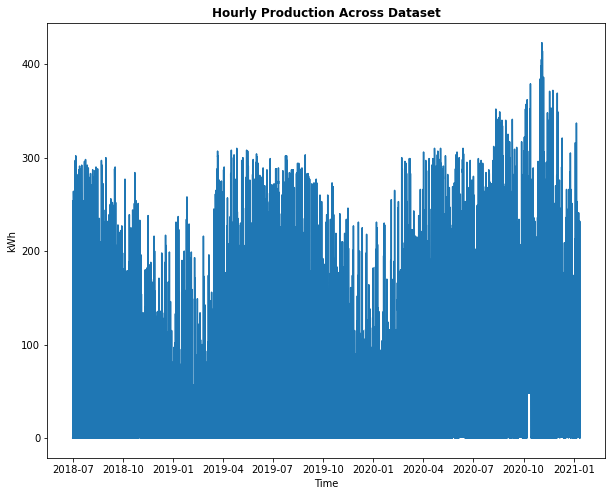

In [10]:
plt.figure(figsize=(10,8))
sns.lineplot(df['ds'],df['y'])
plt.title('Hourly Production Across Dataset', fontweight='bold')
plt.xlabel('Time')
plt.ylabel('kWh')

It's difficult to see with the hourly data since it is so densly packed. But you can see a subtle trend in the plot above. Towards the end of each year there is a small divot in energy production. This signifies lower overall production during Winter months. I will now plot the daily sum to see if this can be seen more clearly. First I need to resample the frequency to daily.

In [11]:
explore_df = df.set_index('ds')

In [12]:
daily = explore_df.resample('D').sum()

Text(0, 0.5, 'kWh')

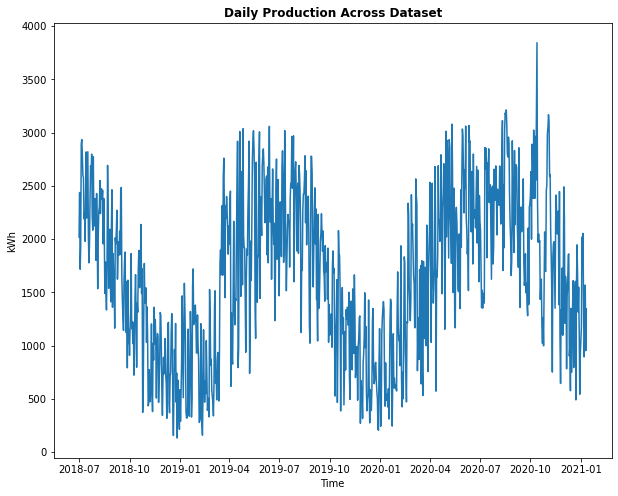

In [13]:
plt.figure(figsize=(10,8))
sns.lineplot(daily.index, daily['y'])
plt.title('Daily Production Across Dataset', fontweight='bold')
plt.xlabel('Time')
plt.ylabel('kWh')

The plot above shows the yearly seasonality much more clearly. You can see a clear dropoff towards the end of each year through the first few months when it then graudally increases into Spring and Summer. Incorporating a yearly seasonality into the Prophet model will be extremely useful. I would like to see the average production total for each month, so I have an idea of how to structure the seasonality component for the model.

In [14]:
avg_monthly_production = explore_df.groupby(explore_df.index.month).mean()

Text(0, 0.5, 'kWh')

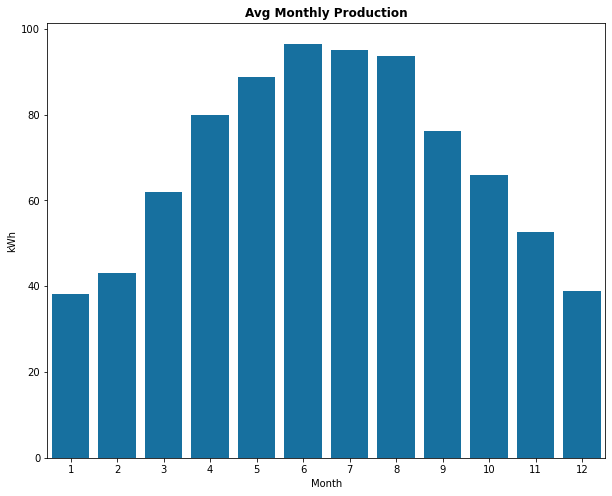

In [15]:
plt.figure(figsize=(10,8))
sns.barplot(avg_monthly_production.index, avg_monthly_production['y'], color='#0077b6')
plt.title('Avg Monthly Production', fontweight='bold')
plt.xlabel('Month')
plt.ylabel('kWh')

The middle months, April-September, all hold pretty steady right around 4,000. October is a little higher on average, but for the most part the three months at the beginning and end of the year produce much less energy than the middle six months. That will be my yearly seasonality component to begin with.

Next I will explore daily fluctuations. To start, I will plot the avg energy production for each hour of the day.

In [16]:
avg_hourly = explore_df.groupby(explore_df.index.hour).mean()

Text(0, 0.5, 'kWh')

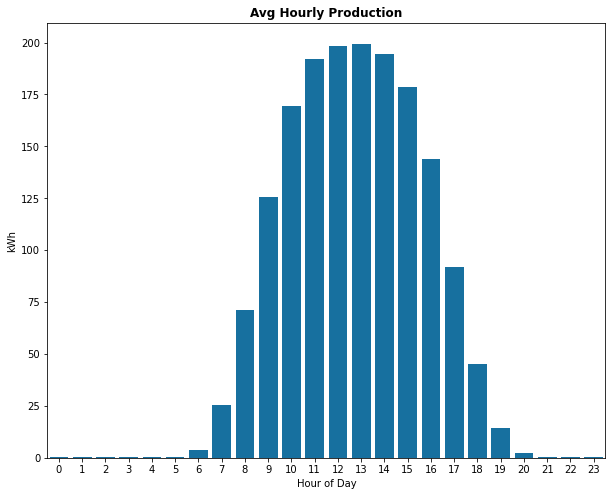

In [17]:
plt.figure(figsize=(10,8))
sns.barplot(avg_hourly.index, avg_hourly['y'], color='#0077b6')
plt.title('Avg Hourly Production', fontweight='bold')
plt.xlabel('Hour of Day')
plt.ylabel('kWh')

The plot above shows a very distinct hourly trend. 

Text(0, 0.5, 'kWh')

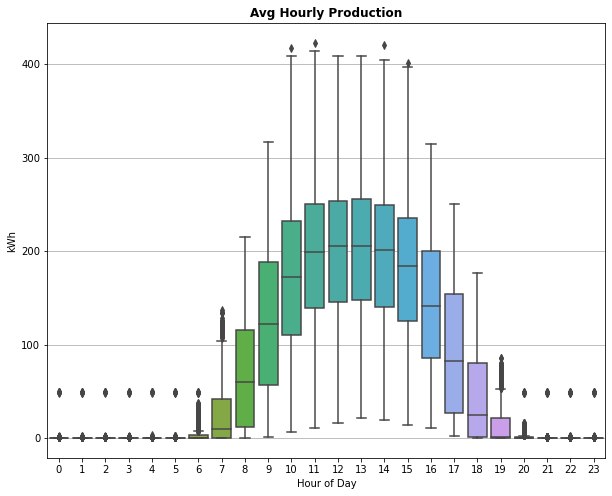

In [18]:
plt.figure(figsize=(10,8))
sns.boxplot(explore_df.index.hour, explore_df['y'])
plt.title('Avg Hourly Production', fontweight='bold')
plt.xlabel('Hour of Day')
plt.gca().grid(axis='y')
plt.gca().set_axisbelow(True)
plt.ylabel('kWh')

This plot conveys mostly the same information as the previous one with the addition of the interquartile range of the boxplots. The wide range emphasizes the dependency that energy production has on weather conditions. If the amount of energy produced was totally reliant on time, the range would be much smaller possibly not there at all. 

I think I have a thorough enough understanding of the data to begin creating some basic models.

## Modeling
### Model 1

I will begin by creating a baseline model using default parameters before tuning to increase performance. This will give a good idea of how model iterations improve going forward.

First I need to split the data into training and test sets. In production I want my model to forecast anywhere from 6-24 hours in advance. So I can keep the majority of data for training. I will use December 2020 through the end of the dataset as testing data and the rest as training data

In [19]:
model_df = df.copy()

In [20]:
train = model_df[(model_df['ds'] < '2020-12-01')]
test = model_df[model_df['ds'] >= '2020-12-01']

Now I can create a baseline Prophet model

In [21]:
m1 = Prophet()
m1.fit(train)

In order to make predictions, prophet provides the make_future_dataframe method which includes all of the training data as well as specified period for forecasting. In this case the forecast period will be the size of the test data.

In [22]:
future1 = m1.make_future_dataframe(periods=len(test), freq='H')

Now we can make predictions

In [23]:
forecast1 = m1.predict(future1)

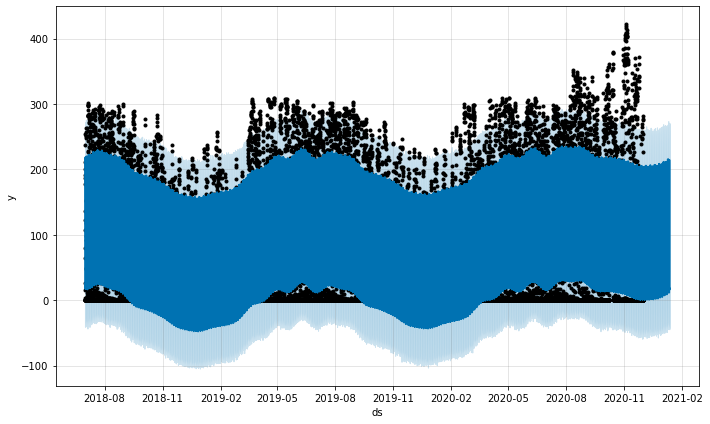

In [24]:
m1.plot(forecast1);

The black dots represent the actual data, the dark blue area is the models predictions, and the light blue shading is the confidence interval. This plot gives a general idea but the plot used in teh reference at the top of this notebook is much more informative. All credit for code of this plot goes to author of article linked at top of this notebook.

I will be creating this plot more than once, as I do more model iterations, so I am going to create a function that does it.

In [25]:
def plot_results(train, test, forecast):
    plt.figure(figsize=(12,10))

    plt.scatter(train['ds'], train['y'], color='b', alpha=.6, edgecolor='w', label='Training True')
    plt.scatter(test['ds'], test['y'], color='y', alpha=.6, edgecolor='w', label='Testing True')
    plt.scatter(forecast['ds'], forecast['yhat'], color='r', alpha=.6, edgecolor='k', label='Predictions')

    plt.title('Forecasts of Hourly Solar Energy Production')
    plt.ylabel('kWh Production')
    plt.xlabel('Time')
    plt.legend()
    plt.grid(axis='y', alpha=.7)

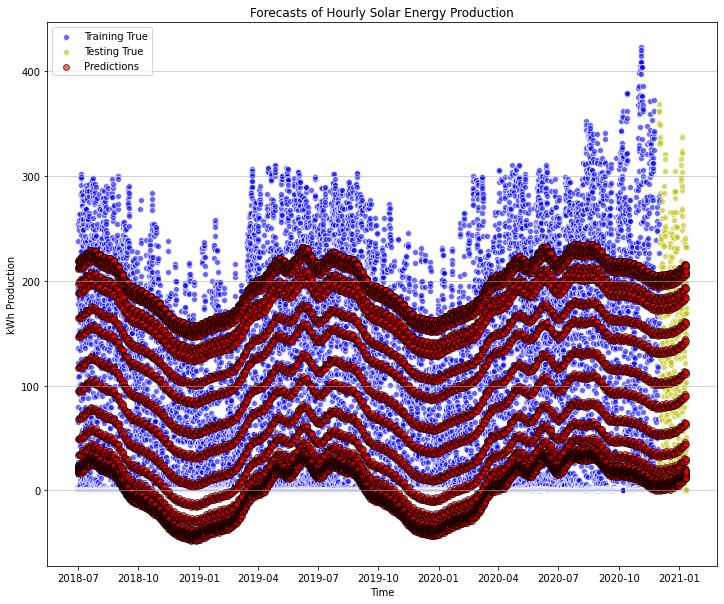

In [26]:
# plot results from baseline model
plot_results(train, test, forecast1)

The model performed poorly just as expected. Before moving on to iterations, I want to calculate the r2 and mae for this baseline model.

In [27]:
forecast1_train = forecast1[forecast1['ds'] < '2020-12-01']
forecast1_test = forecast1[forecast1['ds'] >= '2020-12-01']

In [28]:
print('Train R2: ', r2(train['y'], forecast1_train['yhat']))
print('Train MAE: ', mae(train['y'], forecast1_train['yhat']))
print('Test R2: ', r2(test['y'], forecast1_test['yhat']))
print('Test MAE: ', mae(test['y'], forecast1_test['yhat']))

Train R2:  0.7921500071065634
Train MAE:  32.87699533120848
Test R2:  0.6929411766512912
Test MAE:  34.48967210025911


Since I am primarily concerned with the first 6-24 hours of the forecast, I am going to check those to see how the model did for the shorter time frame.

In [29]:
print('6 Hour Test R2: ', r2(test.iloc[:6]['y'], forecast1_test.iloc[:6]['yhat']))
print('6 Hour Test MAE: ', mae(test.iloc[:6]['y'], forecast1_test.iloc[:6]['yhat']))
print('24 Hour Test R2: ', r2(test.iloc[:24]['y'], forecast1_test.iloc[:24]['yhat']))
print('24 Hour Test MAE: ', mae(test.iloc[:24]['y'], forecast1_test.iloc[:24]['yhat']))

6 Hour Test R2:  0.0
6 Hour Test MAE:  3.430013544994646
24 Hour Test R2:  0.6939651625773711
24 Hour Test MAE:  52.67230549119585


It seems the model may have performed better on the shorter time frame forecasts.

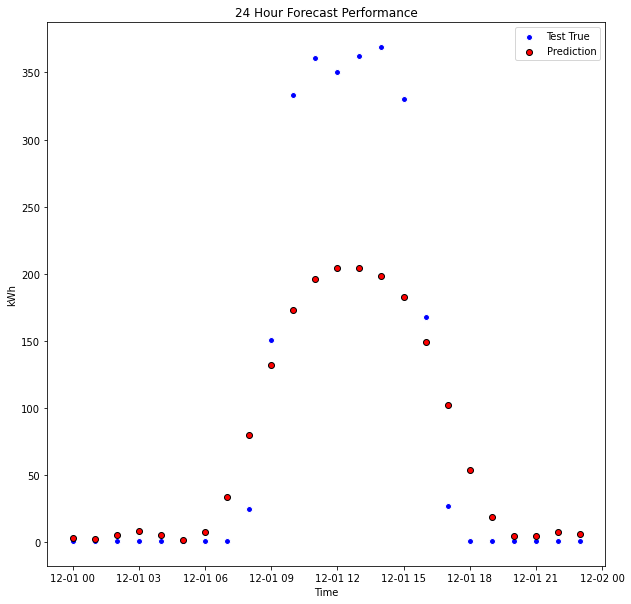

In [30]:
plt.figure(figsize=(10,10))
plt.scatter(test.iloc[:24]['ds'], test.iloc[:24]['y'], color='b', edgecolor='w', label='Test True')
plt.scatter(forecast1_test.iloc[:24]['ds'], forecast1_test.iloc[:24]['yhat'], color='r', edgecolor='k', label='Prediction')
plt.title('24 Hour Forecast Performance')
plt.xlabel('Time')
plt.ylabel('kWh')
plt.legend()

The model explained about 60% of the variance for the training data and about 40% for the testing data. It should be noted that there is an unusal massive spike in the testing data that will be difficult for the model to predict. I'm not sure if it is faulty data or just unusually sunny Winter months, but the model is going to struggle to predict that.

### Model 2

Now I am going to include some additional parameters to try and improve model performance.

As seen in the average monthly production plot above, the month of the year plays a major role in how much energy will be produced in an hour. To account for this I am going to add a seasonality that states whether the day is in a month that has high avg production or low avg production. The author of the blog referenced above does the same, all code credit goes to them.  

Also since the avg weekly energy production does not fluctuate too much on a week to week basis I will set weekly_seasonality to false.

In [31]:
def on_season(ds):
    date = pd.to_datetime(ds)
    return ((date.month >= 3) & (date.month <= 9))

model_df['on_season'] = model_df['ds'].apply(on_season)
model_df['off_season'] = ~model_df['ds'].apply(on_season)

In [32]:
train = model_df[(model_df['ds'] < '2020-12-01')]
test = model_df[model_df['ds'] >= '2020-12-01']

In [33]:
m2 = Prophet(weekly_seasonality=False)

m2.add_seasonality(name='on_season_daily', period=1, condition_name='on_season', fourier_order=6)
m2.add_seasonality(name='off_season_daily', period=1, condition_name='off_season', fourier_order=6)

In [34]:
m2.fit(train)

In [35]:
test.tail()

,ds,y,on_season,off_season
22212,2021-01-11 19:00:00,1.0,False,True
22213,2021-01-11 20:00:00,1.0,False,True
22214,2021-01-11 21:00:00,1.0,False,True
22215,2021-01-11 22:00:00,1.0,False,True
22216,2021-01-11 23:00:00,0.0,False,True


I also need to add the additional two columns to the future dataframe.

In [36]:
future2 = m2.make_future_dataframe(periods=len(test), freq='H')

future2['on_season'] = future2['ds'].apply(on_season)
future2['off_season'] = ~future2['ds'].apply(on_season)

In [37]:
forecast2 = m2.predict(future2)

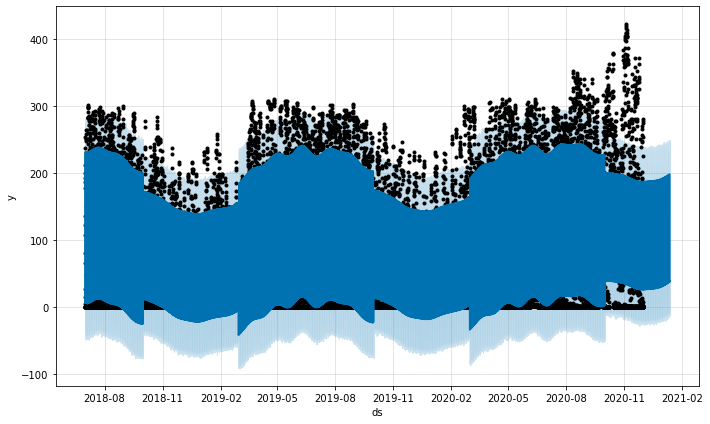

In [38]:
m1.plot(forecast2);

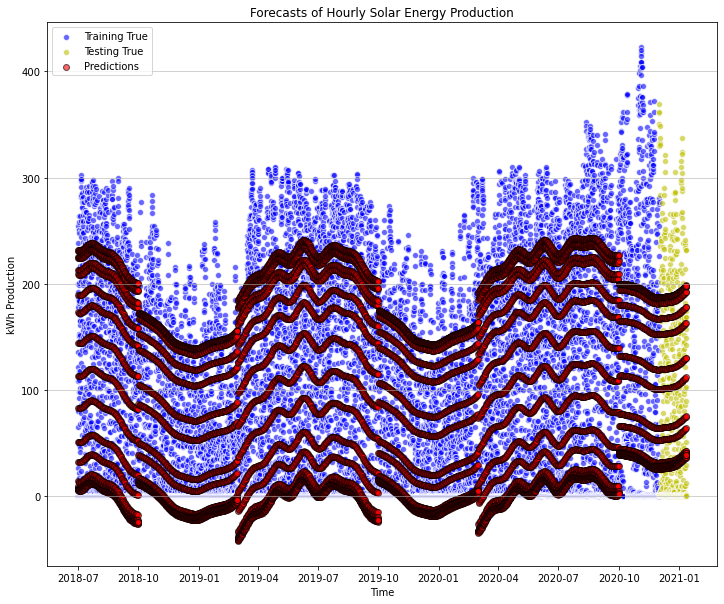

In [39]:
plot_results(train, test, forecast2)

In [40]:
def print_results(train, test, forecast):
    forecast_train = forecast[forecast['ds'] <= train.iloc[-1]['ds']]
    forecast_test = forecast[forecast['ds'] >= test.iloc[0]['ds']]

    print('Train R2: ', r2(train['y'], forecast_train['yhat']))
    print('Train MAE: ', mae(train['y'], forecast_train['yhat']))
    print('Test R2: ', r2(test['y'], forecast_test['yhat']))
    print('Test MAE: ', mae(test['y'], forecast_test['yhat']))

In [41]:
def plot_short_term_results(test, forecast):
    forecast_test = forecast[forecast['ds'] >= test.iloc[0]['ds']]
    plt.figure(figsize=(10,10))
    plt.scatter(test['ds'], test['y'], color='b', edgecolor='w', label='Test True')
    plt.scatter(forecast_test['ds'], forecast_test['yhat'], color='r', edgecolor='k', label='Prediction')
    plt.title('24 Hour Forecast Performance')
    plt.xlabel('Time')
    plt.ylabel('kWh')
    plt.legend()

In [42]:
def get_results(train, test, forecast):
    plot_results(train, test, forecast)
    plot_short_term_results(test, forecast)
    print_results(train, test, forecast)

Train R2:  0.830999190975953
Train MAE:  26.42074866503166
Test R2:  0.7237637037853558
Test MAE:  39.78050064666748


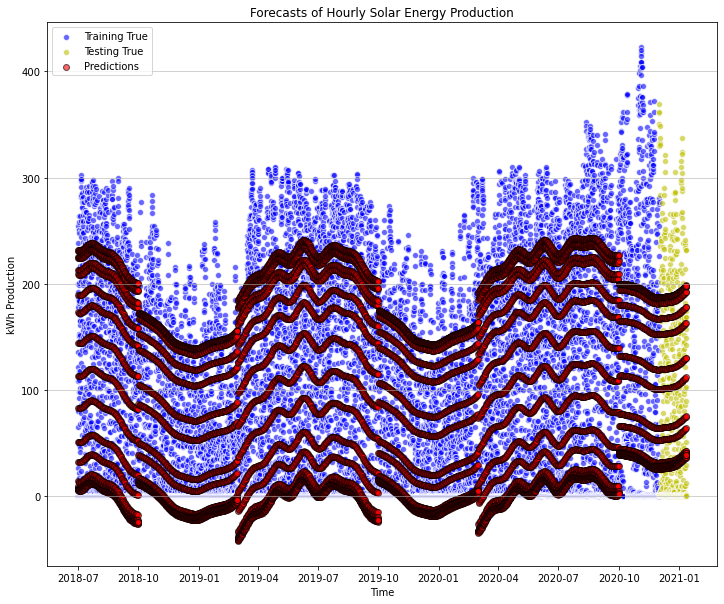

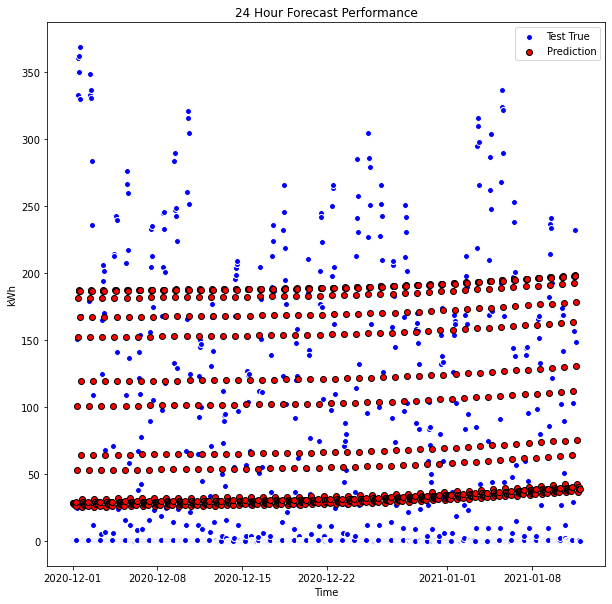

In [43]:
get_results(train, test, forecast2)

In [44]:
m3 = Prophet(weekly_seasonality=False,daily_seasonality=False,yearly_seasonality=False)

m3.add_seasonality(name='on_season_daily', period=1, condition_name='on_season', fourier_order=6)
m3.add_seasonality(name='off_season_daily', period=1, condition_name='off_season', fourier_order=6)
m3.add_seasonality(name='yearly', period=365.5, fourier_order=15)

In [45]:
m3.fit(train)

In [46]:
future3 = m3.make_future_dataframe(periods=len(test), freq='H')

future3['on_season'] = future3['ds'].apply(on_season)
future3['off_season'] = ~future3['ds'].apply(on_season)

In [47]:
forecast3 = m3.predict(future3)

Train R2:  0.8325657954057345
Train MAE:  26.440747407122306
Test R2:  0.715385728860864
Test MAE:  40.58229882944835


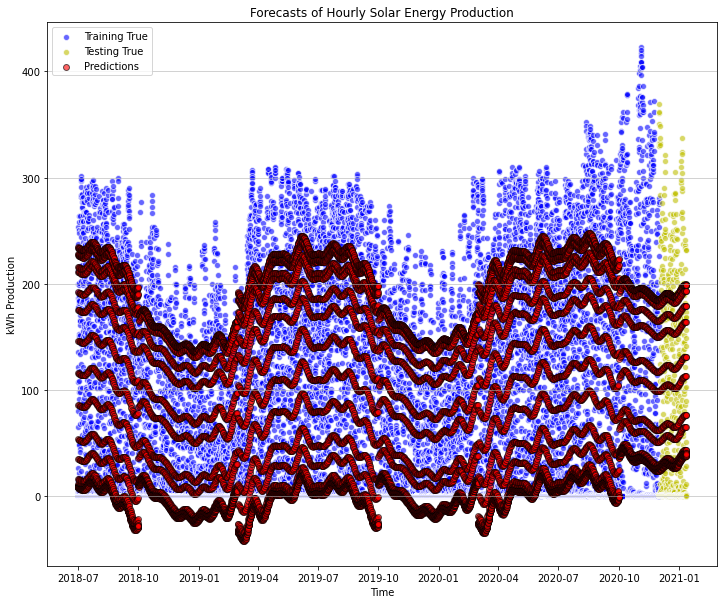

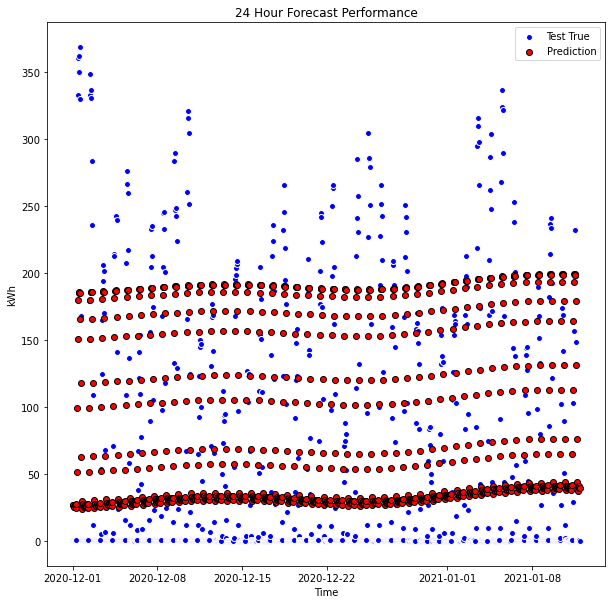

In [48]:
get_results(train, test, forecast3)

In [49]:
test.iloc[-24:]['ds']== forecast3.iloc[-24:]['ds']

22193    True
22194    True
22195    True
22196    True
22197    True
22198    True
22199    True
22200    True
22201    True
22202    True
22203    True
22204    True
22205    True
22206    True
22207    True
22208    True
22209    True
22210    True
22211    True
22212    True
22213    True
22214    True
22215    True
22216    True
Name: ds, dtype: bool

In [50]:
forecast3.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,off_season_daily,...,on_season_daily,on_season_daily_lower,on_season_daily_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
22212,2021-01-11 19:00:00,115.293895,-12.917499,86.543401,114.426992,116.251956,-77.545235,-77.545235,-77.545235,-49.130768,...,0.0,0.0,0.0,-28.414467,-28.414467,-28.414467,0.0,0.0,0.0,37.748660
22213,2021-01-11 20:00:00,115.303120,-6.132295,89.884876,114.435170,116.262399,-74.206563,-74.206563,-74.206563,-45.776123,...,0.0,0.0,0.0,-28.430440,-28.430440,-28.430440,0.0,0.0,0.0,41.096557
22214,2021-01-11 21:00:00,115.312345,-8.742883,93.527813,114.443347,116.272843,-74.166444,-74.166444,-74.166444,-45.719918,...,0.0,0.0,0.0,-28.446526,-28.446526,-28.446526,0.0,0.0,0.0,41.145900
22215,2021-01-11 22:00:00,115.321569,-8.286626,85.435843,114.451525,116.283286,-76.022661,-76.022661,-76.022661,-47.559940,...,0.0,0.0,0.0,-28.462721,-28.462721,-28.462721,0.0,0.0,0.0,39.298908
22216,2021-01-11 23:00:00,115.330794,-9.809190,88.283188,114.459703,116.293730,-75.804291,-75.804291,-75.804291,-47.325271,...,0.0,0.0,0.0,-28.479021,-28.479021,-28.479021,0.0,0.0,0.0,39.526503


In [51]:
test.tail()

,ds,y,on_season,off_season
22212,2021-01-11 19:00:00,1.0,False,True
22213,2021-01-11 20:00:00,1.0,False,True
22214,2021-01-11 21:00:00,1.0,False,True
22215,2021-01-11 22:00:00,1.0,False,True
22216,2021-01-11 23:00:00,0.0,False,True


In [52]:
model_df.y = np.cbrt(model_df.y)

train = model_df[(model_df['ds'] < '2020-12-01')]
test = model_df[model_df['ds'] >= '2020-12-01']

In [53]:
m4 = Prophet(weekly_seasonality=False,daily_seasonality=False,yearly_seasonality=False)

m4.add_seasonality(name='on_season_daily', period=1, condition_name='on_season', fourier_order=6)
m4.add_seasonality(name='off_season_daily', period=1, condition_name='off_season', fourier_order=6)
m4.add_seasonality(name='yearly', period=365.5, fourier_order=25)

In [54]:
m4.fit(train)

In [55]:
future4 = m4.make_future_dataframe(periods=len(test), freq='H')

future4['on_season'] = future4['ds'].apply(on_season)
future4['off_season'] = ~future4['ds'].apply(on_season)

In [56]:
forecast4 = m4.predict(future4)

In [57]:
train.y = train.y**3
test.y = test.y**3
forecast4.yhat = forecast4.yhat**3

Train R2:  0.8495448256391569
Train MAE:  20.048539922499092
Test R2:  0.8155218526072401
Test MAE:  18.931812447320137


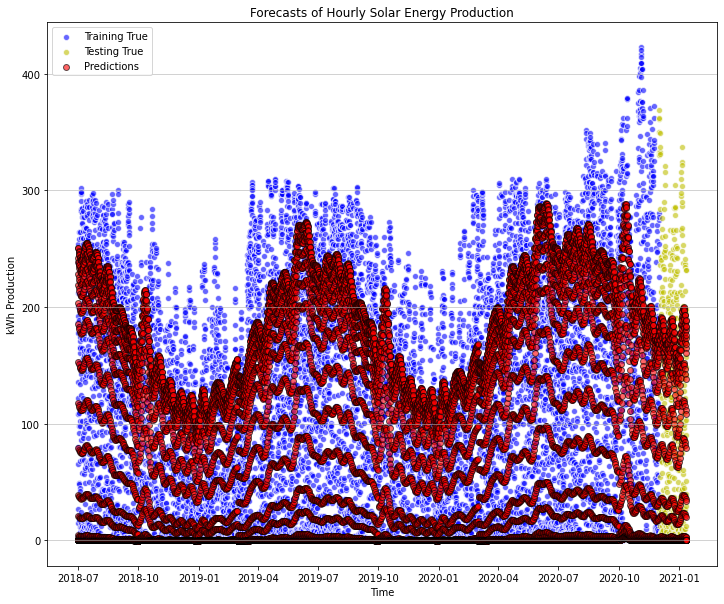

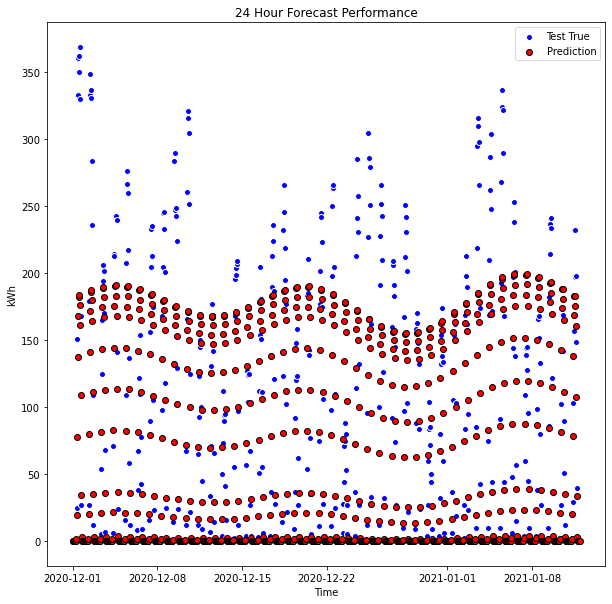

In [58]:
get_results(train, test, forecast4)

In [59]:
df7 = df.copy()

In [60]:
df7 = df7[df7['ds'] >= '2020-12-29']

In [61]:
df7.head()

,ds,y
21881,2020-12-29 00:00:00,0.0
21882,2020-12-29 01:00:00,0.0
21883,2020-12-29 02:00:00,1.0
21884,2020-12-29 03:00:00,1.0
21885,2020-12-29 04:00:00,0.0


In [62]:
df.tail()

,ds,y
22212,2021-01-11 19:00:00,1.0
22213,2021-01-11 20:00:00,1.0
22214,2021-01-11 21:00:00,1.0
22215,2021-01-11 22:00:00,1.0
22216,2021-01-11 23:00:00,0.0


In [63]:
train = df7[df7['ds'] < '2021-01-10']
val = df7[(df7['ds'] >= '2021-01-10') & (df7['ds'] < '2021-01-11')]
test = df7[df7['ds'] >= '2021-01-11']

In [64]:
print('Train: ', len(train))
print('Val: ', len(val))
print('Test: ', len(test))

Train:  288
Val:  24
Test:  24


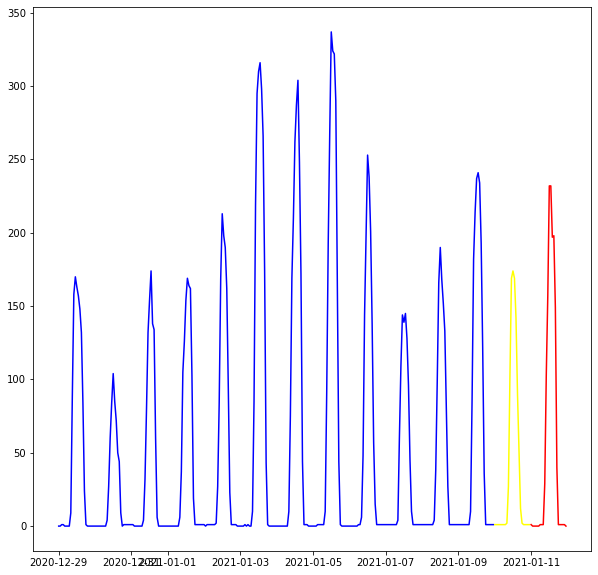

In [65]:
plt.figure(figsize=(10,10))
plt.plot(train['ds'], train['y'], color='blue')
plt.plot(val['ds'], val['y'], color='yellow')
plt.plot(test['ds'], test['y'], color='red')

In [66]:
train = df7[df7['ds'] < '2021-01-09']
val = df7[(df7['ds'] >= '2021-01-09') & (df7['ds'] < '2021-01-10')]
test = df7[df7['ds'] >= '2021-01-10']

In [67]:
m7 = Prophet(weekly_seasonality=False, daily_seasonality=20, yearly_seasonality=False, changepoint_prior_scale=.75)

In [68]:
m7.fit(train)

In [69]:
future7 = m7.make_future_dataframe(periods=len(val), freq='H')


In [70]:
forecast7 = m7.predict(future7)

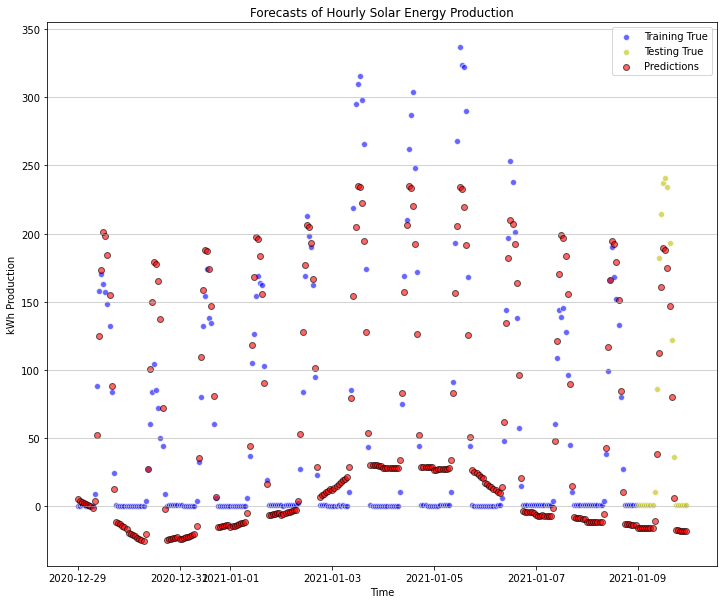

In [71]:
plot_results(train, val, forecast7)

In [72]:
forecast7_train = forecast7[forecast7['ds'] <= train.iloc[-1]['ds']]
forecast7_val = forecast7[(forecast7['ds'] >= val.iloc[0]['ds']) & (forecast7['ds'] <= val.iloc[-1]['ds'])]

In [73]:
print('Train R2: ', r2(train['y'], forecast7_train['yhat']))
print('Train MAE: ', mae(train['y'], forecast7_train['yhat']))
print('Test R2: ', r2(val['y'], forecast7_val['yhat']))
print('Test MAE: ', mae(val['y'], forecast7_val['yhat']))

Train R2:  0.8777996349487392
Train MAE:  21.94008737508689
Test R2:  0.8623911876046204
Test MAE:  30.0979784308067


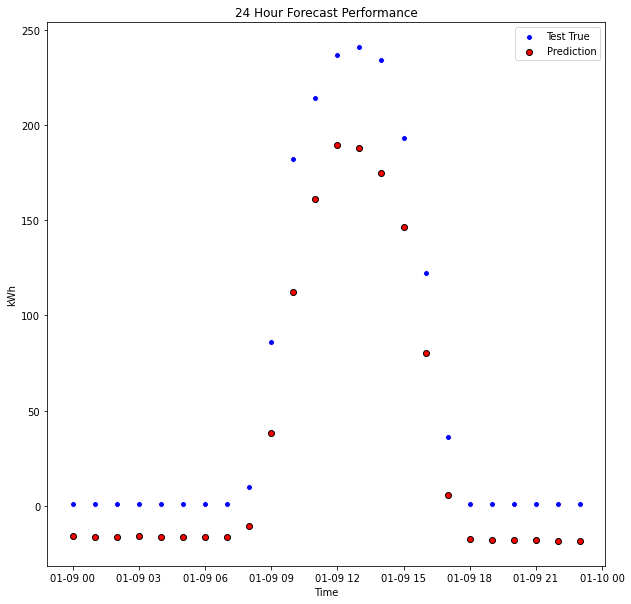

In [74]:
plot_short_term_results(val, forecast7)

.86 for validation is sufficient enough for an MVP model. Now I can train the model on both training and validation and predict the test set

In [75]:
final_train = df7[df7['ds'] < '2021-01-11']
final_test = df7[df7['ds'] >= '2021-01-11']

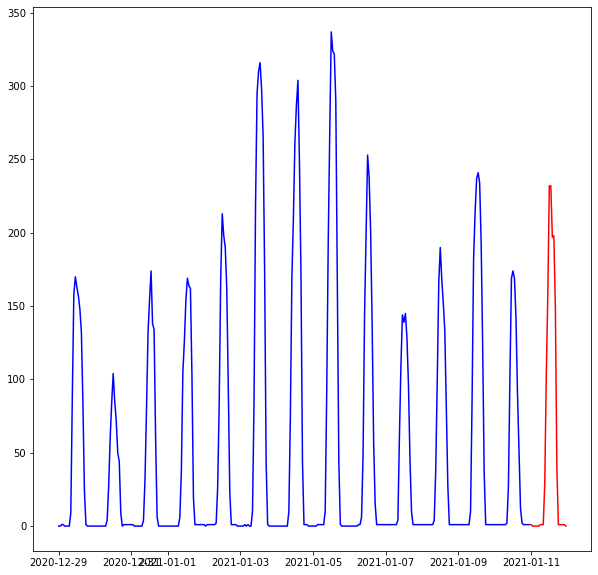

In [76]:
plt.figure(figsize=(10,10))
plt.plot(final_train['ds'], final_train['y'], color='blue')
plt.plot(final_test['ds'], final_test['y'], color='red')

In [77]:
# Prophet model with same parameters as previous model
m8 = Prophet(weekly_seasonality=False, daily_seasonality=15, yearly_seasonality=False, changepoint_prior_scale=.5)

In [78]:
m8.fit(final_train)

In [79]:
future8 = m8.make_future_dataframe(periods=len(final_test), freq='H')

In [80]:
forecast8 = m8.predict(future8)

In [81]:
forecast8_train = forecast8[forecast8['ds'] <= final_train.iloc[-1]['ds']]
forecast8_test = forecast8[forecast8['ds'] >= final_test.iloc[0]['ds']]

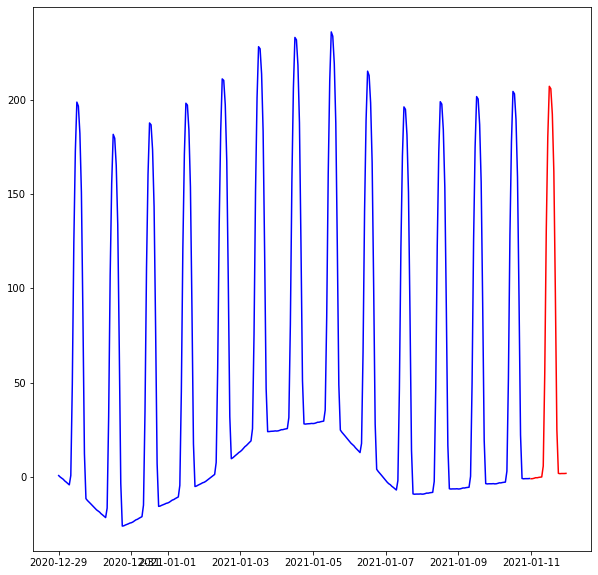

In [82]:
plt.figure(figsize=(10,10))
plt.plot(forecast8_train['ds'], forecast8_train['yhat'], color='blue')
plt.plot(forecast8_test[-24:]['ds'], forecast8_test[-24:]['yhat'], color='red')

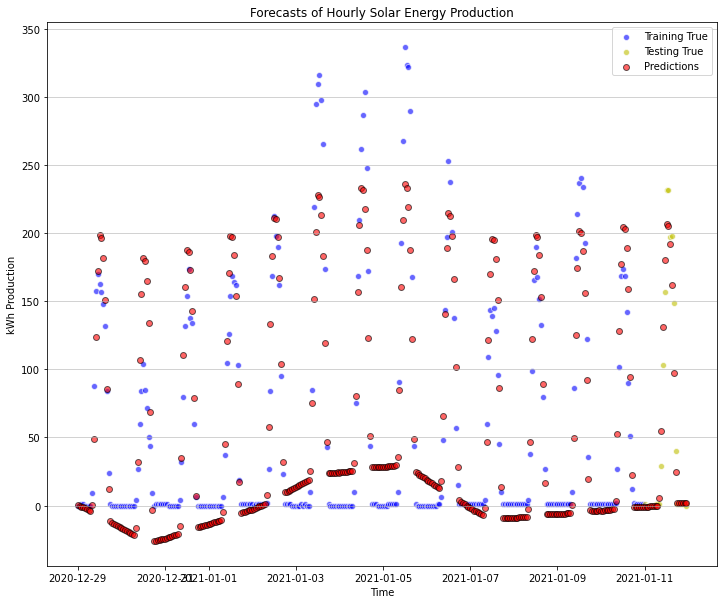

In [83]:
    plt.figure(figsize=(12,10))

    plt.scatter(final_train['ds'], final_train['y'], color='b', alpha=.6, edgecolor='w', label='Training True')
    plt.scatter(final_test['ds'], final_test['y'], color='y', alpha=.6, edgecolor='w', label='Testing True')
    plt.scatter(forecast8['ds'], forecast8['yhat'], color='r', alpha=.6, edgecolor='k', label='Predictions')

    plt.title('Forecasts of Hourly Solar Energy Production')
    plt.ylabel('kWh Production')
    plt.xlabel('Time')
    plt.legend()
    plt.grid(axis='y', alpha=.7)

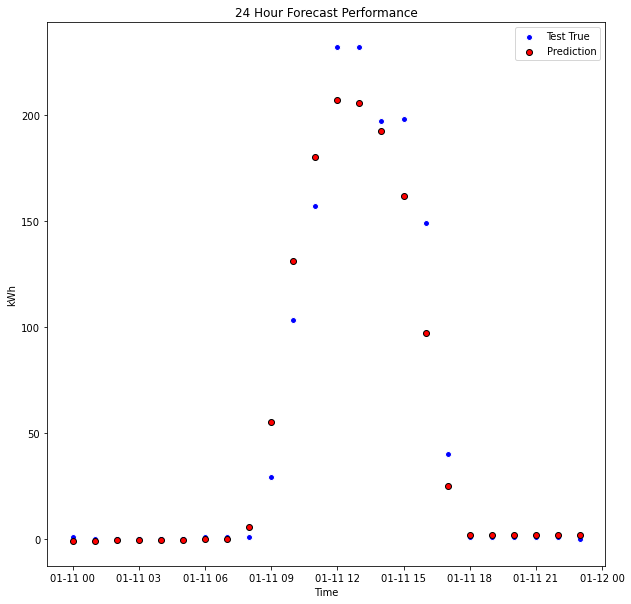

In [84]:
plot_short_term_results(final_test, forecast8)

In [85]:
print('Train R2: ', r2(final_train['y'], forecast8_train['yhat']))
print('Train MAE: ', mae(final_train['y'], forecast8_train['yhat']))
print('Test R2: ', r2(final_test['y'], forecast8_test['yhat']))
print('Test MAE: ', mae(final_test['y'], forecast8_test['yhat']))

Train R2:  0.8804045247093553
Train MAE:  20.708190468920545
Test R2:  0.955416579854523
Test MAE:  10.575298387027901


Final testing results were great. The model explained over 95% of the variance in the testing data. Looking at the plot above though I can see that the model does not have great consistency. This is something I will address in future iterations. For now, this model is more than adequate to implement into MVP flask application.

Final notes, the best performing model just used the previous two weeks of data for training and predicted 24 hours in advance. This is how I want to structure flask app mvp.